# MusicRNN
This code generates music using two RNNs
(1) - A Generalist that does not take into account the style of the different composers
(2) - The Specialist, which tries to learn the style of each composer.

The project consists of three main parts:
- Model definitions
- Training
- Song generation


In [3]:
%matplotlib inline
from helpers.dataset import pianoroll_dataset_batch
from models import Generalist
from helpers.datapreparation import *
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np



In [4]:
DATA_DIR = "datasets/training/piano_roll_fs5"
dataset = pianoroll_dataset_batch(DATA_DIR)

In [5]:
print(f"Number of tags (composers): {dataset.num_tags()}")
print(f"Number of keys: {dataset.num_keys()}")
print(f"Size of dataset (number of examples): {len(dataset)}")

Number of tags (composers): 4
Number of keys: 128
Size of dataset (number of examples): 43


In [6]:
# To get first note of first song of first composer:
composer_no = 0
timestep_no = 0
example_no = 0
dataset[example_no][composer_no][timestep_no]

tensor([[0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
         1., 1.]])

In [8]:
notes = dataset[example_no][composer_no].squeeze()
print(f"Shape of notes: {notes.shape}")
#visualize_piano_roll(notes.numpy())      

Shape of notes: torch.Size([1128, 128])


In [9]:
# We cam play by transposing the numpy array of the dataset, since that is what embed_play expects
#embed_play_v1(notes.numpy().T, fs=5)

In [10]:
class Generalist(nn.Module):
    """ The generalists composes music without learning the difference between 
        different composers using an LSTM.
    """    
    
    def __init__(self, input_size, hidden_size, num_layers):
        super(Generalist, self).__init__()
        self.input_size = input_size
        self.output_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.hidden = None
        
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, dropout=(0 if num_layers ==1 else 0.5))
        self.hidden_to_output = nn.Linear(hidden_size, self.output_size)
    
    def init_hidden(self, tag):
        """ Ignore tag - this is just to make models compatible across Generalist and Specialist """
        return  (torch.autograd.Variable(torch.zeros(self.num_layers, 1, self.hidden_size)),
                 torch.autograd.Variable(torch.zeros(self.num_layers, 1, self.hidden_size)))

    def forward(self, inputs, tag=None, hidden=None):
        # Since this is the generalist, don't pass any category info to the model
        hidden = self.hidden if hidden is None else hidden
        output, self.hidden = self.lstm(inputs, hidden)
        output = self.hidden_to_output(output)
        return output, self.hidden


In [11]:
class Specialist(nn.Module):
    """ The specialist composes music based on the composer using an LSTM and an embedding. """    
    
    def __init__(self, input_size, hidden_size, num_layers, num_composers=4):
        super(Specialist, self).__init__()
        self.input_size = input_size
        self.output_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.embedding_size = hidden_size
        self.num_embeddings = num_composers
        self.hidden = None
        
        self.tag_to_hidden = nn.Embedding(num_embeddings = num_composers, embedding_dim = self.embedding_size)
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers)
        self.hidden_to_output = nn.Linear(hidden_size, self.output_size)
    
    def init_hidden(self, tag):
        """ The specialist maps each tag to a starting hidden state. 
            The goal is to learn to differentiate composers"""
        hidden_start = self.tag_to_hidden(tag)
        cell_start = torch.autograd.Variable(torch.zeros(self.num_layers, 1, self.hidden_size))
        return (hidden_start, cell_start)
        

    def forward(self, inputs, tag=None, hidden=None):
        # Specialist => only pass tag as initial hidden state
        hidden = self.hidden if hidden is None else hidden
        output, self.hidden = self.lstm(inputs, hidden)
        output = self.hidden_to_output(output)
        return output, self.hidden


In [12]:
def gen_batch(inputs, targets, batch_size = 32, overlap=8):
    assert len(inputs) == len(targets), "Inputs and targets must have same length"
    length = len(inputs)
    for idx in range(0, length, batch_size-overlap):
        last_idx = min(idx + batch_size - overlap, length)
        yield inputs[idx:last_idx], targets[idx:last_idx]

# Training
Tried out:

*Losses*:
- L1
- L2
- BCEWithLogits

*Optimizers*:
- Adam
- SGD


In [13]:
import time


INPUT_SIZE = 128
HIDDEN_SIZE = 256 
NUM_HIDDEN_LAYERS = 1

#loss_func = nn.MSELoss()
#Tsloss_func = nn.L1Loss()
#loss_func = nn.BCELoss() NOTE! Requires range of outputs to be between 0 and 1
#optimizer = optim.SGD(model.parameters(), lr = 0.01, momentum=0.9)
#optimizer = optim.SparseAdam(model.parameters(), lr=1e-3)
loss_func = nn.BCEWithLogitsLoss()

NUM_EPOCHS = 5
NUM_SONGS = 2
BATCH_SIZE = 100
OVERLAP = 50

specialist = Specialist(INPUT_SIZE, HIDDEN_SIZE, NUM_HIDDEN_LAYERS)
generalist = Generalist(INPUT_SIZE, HIDDEN_SIZE, NUM_HIDDEN_LAYERS)


In [14]:
def train(model):
    optimizer = optim.Adam(model.parameters(), lr=1e-3)
    start = time.time()
    losses = []
    for epoch in range(NUM_EPOCHS+1):
        CUR_SONG = 0
        LOSS_PER_EPOCH = 0
        for inputs, tags, targets in dataset:
            CUR_SONG += 1
            # Since indexing of dataset returns wrong datatype 
            if CUR_SONG > NUM_SONGS:
                continue
            BATCH_LOSS = 0
            for input_batch_seq, target_batch_seq in gen_batch(inputs, targets, BATCH_SIZE, OVERLAP):
                model.zero_grad() # By default, PyTorch cumulates gradients, so remove them
                # Detach hidden from history to clear out hidden state
                model.hidden = model.init_hidden(tags)
                # Forward pass
                output_batch_seq, _ = model(input_batch_seq)
                # Calculate loss and gradients
                loss = loss_func(output_batch_seq, target_batch_seq)
                loss.backward()
                optimizer.step()
                BATCH_LOSS += loss.cpu().detach().numpy()
            print("Epoch {}/{},  processing song {}/{}. Batch Loss: {}".format(epoch, NUM_EPOCHS, CUR_SONG, NUM_SONGS,BATCH_LOSS), end='\r')
            LOSS_PER_EPOCH += BATCH_LOSS
        losses.append(LOSS_PER_EPOCH)
    print("Done!")
    
    end = time.time()

    print(f"Trained for {NUM_EPOCHS} on {NUM_SONGS} - time used: {end-start} seconds")
    return losses

In [15]:

def threshold(tensor, threshold=0.5):
    """ Thresholds the tensor in order to binarize it """
    return tensor > threshold


def avg_keypress(array, min_threshold):
    """ Accepts a binary array and calculates the average number of keypresses in the song"""
    return np.sum(array > min_threshold)/array.shape[0]

def find_threshold(song_array, minval=-100, maxval=100, keypresses_per_timestep=2.5, max_iter=15):
    """ Finds the threshold that makes the average number of keypresses per timestep as close as possible
        to the determined number of keypresses by binary search.
    """
    for cur_iter in range(max_iter):
        val = (minval + maxval)/2
        avg_kp = avg_keypress(song_array, val)
        # More keypresses than wanted => Increase threshold
        if avg_kp > keypresses_per_timestep: 
            minval = val
        # Less keypresses than wanted => Decrease threshold
        else:
            maxval = val
    return val        

In [16]:
print("Training generalist...")
gen_loss = train(generalist)
print("Training specialist...")
spec_loss = train(specialist)

Training generalist...
Done! 5/5,  processing song 2/2. Batch Loss: 1.4565308801829815
Trained for 5 on 2 - time used: 13.074855327606201 seconds
Training specialist...
Done! 5/5,  processing song 2/2. Batch Loss: 1.3102565966546535
Trained for 5 on 2 - time used: 13.966777086257935 seconds


In [15]:
# We can save our models weights in order to use it for inference later.
#if isinstance(model, Generalist):
torch.save(generalist.state_dict(), f"generalist_{NUM_EPOCHS}_{BATCH_SIZE}_{OVERLAP}_TEST.pt")
#else:
torch.save(specialist.state_dict(), f"specialist_{NUM_EPOCHS}_{BATCH_SIZE}_{OVERLAP}_TEST.pt")

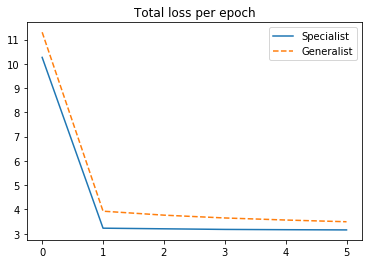

In [17]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.title('Total loss per epoch')
plt.plot(range(len(spec_loss)), spec_loss, '-', range(len(gen_loss)), gen_loss, '--')
plt.legend(['Specialist', 'Generalist'])

In [ ]:
"""
We can make the model generate the whole learned song by passing it as input to the trained model
"""

song_num = 0
with torch.no_grad():
    song = dataset[song_num][0]
    output, _ = specialist(song)

In [2]:
#min_threshold = find_threshold(output,keypresses_per_timestep=2.5)
#piano_roll = threshold(output, threshold=min_threshold)
#visualize_piano_roll(piano_roll.T)
#embed_play_v1(piano_roll.T, fs=5)

# Song Generation
In order for the model to generate a new song, we pass in the sequence one timestep at a time, and get the hidden state out. The output and the hidden state will be fed into the model at the next timestep.

In [18]:

def generate_song(model, song, composer, num_timesteps=10):
    # Uses the first few timesteps from a song and lets the model generate the next
    output_length = song.shape[0]
    output_threshold = 0
    song_timesteps = song[1:num_timesteps+1, :]
    new_song = np.zeros_like(song)
    hidden = model.init_hidden(composer)
    for timestep in range(output_length):
        if timestep < num_timesteps:
            inputs = song_timesteps[timestep, :].unsqueeze(0)
        else:
            inputs = output.detach()
            inputs = inputs.ge(output_threshold).float()
        output, hidden = model(inputs, hidden)  
        new_song[timestep, :] = output.detach().cpu().numpy()
    return new_song.squeeze()
    



In [22]:
""" Uncomment this to generate songs for the trained models
song_num = 0
song, composer = dataset[song_num][0:2] # Second index is inputs, tags, targets
print(composer)
song_generalist = generate_song(generalist, song, composer, num_timesteps=200)
song_specialist = generate_song(specialist, song, composer, num_timesteps=200)
# Use binary search to find the best threshold

generalist_threshold = find_threshold(song_generalist, keypresses_per_timestep=2.5)
specialist_threshold = find_threshold(song_specialist, keypresses_per_timestep=2.5)


generalist_music = threshold(song_generalist, generalist_threshold)
specialist_music = threshold(song_specialist, specialist_threshold)
"""

'\nsong_num = 0\nsong, composer = dataset[song_num][0:2] # Second index is inputs, tags, targets\nprint(composer)\nsong_generalist = generate_song(generalist, song, composer, num_timesteps=200)\nsong_specialist = generate_song(specialist, song, composer, num_timesteps=200)\n# Use binary search to find the best threshold\n\ngeneralist_threshold = find_threshold(song_generalist, keypresses_per_timestep=2.5)\nspecialist_threshold = find_threshold(song_specialist, keypresses_per_timestep=2.5)\n\n\ngeneralist_music = threshold(song_generalist, generalist_threshold)\nspecialist_music = threshold(song_specialist, specialist_threshold)\n'

In [39]:
#visualize_piano_roll(generalist_music.T)
#visualize_piano_roll(specialist_music.T)
#embed_play_v1(generalist_music.T, fs=5)


In [40]:
#embed_play_v1(specialist_music.T, fs=5)

In [28]:
"""
Lets generate different styles of music based on the same song with the given model
"""

def generate_composer_styles(model, song, num_timesteps=10, num_styles=4):
    specialist_songs = []
    for i in range(num_styles):
        print("Generating song {} of {}".format(i+1, num_styles), end='\r')
        song_gen = generate_song(model, song, composer=torch.LongTensor(0), num_timesteps=num_timesteps)
        thresh = find_threshold(song_gen, keypresses_per_timestep=2.5)
        song_gen = threshold(song_gen, thresh)
        visualize_piano_roll(song_gen.T)
        specialist_songs.append(song_gen)
    return specialist_songs

In [20]:
# Load a single midi file and returns the matrix representation of it


def load_song(midi_path):
    # Save the file as csv
    filepath = midfile_to_piano_roll(midi_path,fs=5)
    piano_roll = pd.read_csv(filepath)
    return piano_roll.values

#roll = load_song('datasets/training/brahms_im6.mid')
#visualize_piano_roll(roll)
#embed_play_v1(roll, fs=5)

# Load previous trained models
We can load pretrained models in order to skip training. All the song generation methods used above can be called to generate new music with the loaded model.

In [21]:
!ls models/

generalist_1000_100_50_FINAL_EXPORT.pt	specialist_100_32_16_FINAL.pt
generalist_100_20_10.pt			specialist_20_20_10_.pt
generalist_100_32_16_FINAL.pt		specialist_20_20_10_sparse.pt
specialist_1000_100_50_FINAL_EXPORT.pt


In [22]:
specialist = Specialist(INPUT_SIZE, HIDDEN_SIZE, NUM_HIDDEN_LAYERS)
specialist.load_state_dict(torch.load('models/specialist_1000_100_50_FINAL_EXPORT.pt', map_location='cpu'))

generalist = Generalist(INPUT_SIZE, HIDDEN_SIZE, NUM_HIDDEN_LAYERS)
generalist.load_state_dict(torch.load('models/generalist_1000_100_50_FINAL_EXPORT.pt', map_location='cpu'))

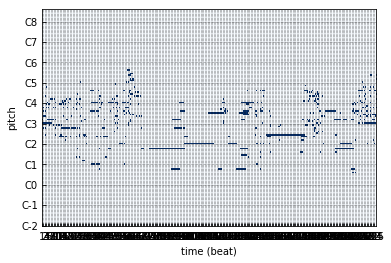

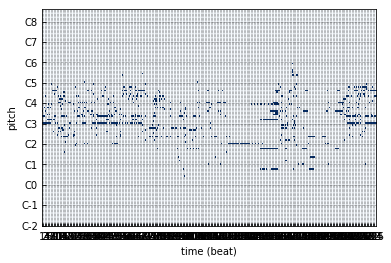

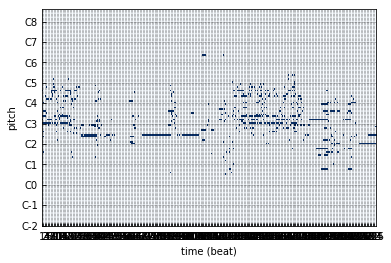

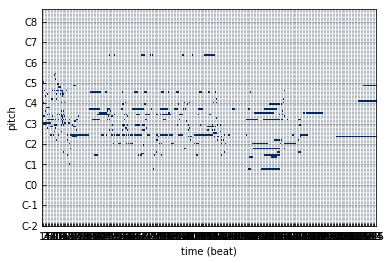

In [23]:
# Generate songs in the style of specialist
chosen_song = dataset[0][0]
specialist_songs = generate_composer_styles(specialist, chosen_song, num_timesteps=30, num_styles=4)


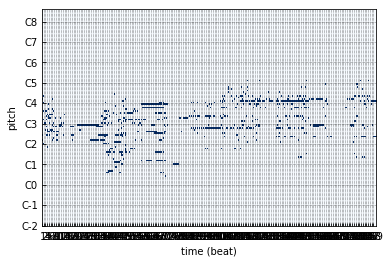

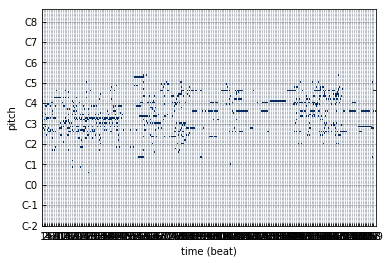

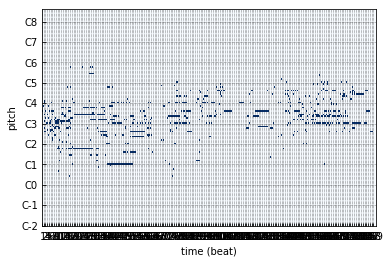

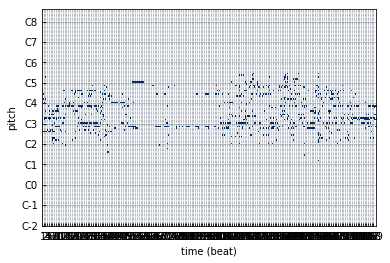

In [26]:
# Generate songs in the style of generalist
chosen_song = dataset[1][0]
generalist_songs = generate_composer_styles(generalist, chosen_song, num_timesteps=30, num_styles=4)


In [24]:
# Play specialist song
# Composers: Bach, Brahms, Debussy, Mozart 
spec_song = specialist_songs[0]
embed_play_v1(spec_song.T, fs=5)

In [27]:
gen_song = generalist_songs[1]
embed_play_v1(gen_song.T, fs=5)

# Improvements / interesting things
- Loss function that takes into account key - might punish activations that are in the wrong key more than activations that are in the right key
- More flexible thresholding
- Experiment with different types of recurrent neural networks 
- Try out GANs (C-RNN-GAN for example) *Mogren, O. (2016). C-RNN-GAN: Continuous recurrent neural networks with adversarial training. arXiv preprint arXiv:1611.09904.*
- Express differences in composers more clearly (special embedding)